## **Imports**

In [1]:
import random
import numpy as np
from copy import deepcopy
import shutil

from tqdm import tqdm
from PIL import Image
import pandas as pd

import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import DataLoader, Dataset, random_split, WeightedRandomSampler
from torchvision.transforms.v2 import Compose, ToImage, Normalize, ToPILImage, Resize, ToDtype
from torchvision.datasets import ImageFolder
from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau, MultiStepLR, CyclicLR, LambdaLR

import matplotlib.pyplot as plt
import requests
import zipfile
import os
import errno
from tqdm import tqdm

plt.style.use('fivethirtyeight')

## **Função para dividir o dataset e criar os diretórios**

In [2]:
def split_dataset(
    input_dir, output_dir, split_ratio=0.8, seed=42
):
    random.seed(seed)

    # Cria pastas de saída
    for split in ['train', 'val']:
        split_path = os.path.join(output_dir, split)
        os.makedirs(split_path, exist_ok=True)

    # Para cada classe
    for class_name in os.listdir(input_dir):
        class_path = os.path.join(input_dir, class_name)
        if not os.path.isdir(class_path):
            continue

        # Lista todos os arquivos de imagem
        files = [f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))]
        random.shuffle(files)

        # Divide conforme o split_ratio
        split_idx = int(len(files) * split_ratio)
        train_files = files[:split_idx]
        val_files = files[split_idx:]

        # Copia os arquivos para suas novas pastas
        for split, split_files in [('train', train_files), ('val', val_files)]:
            split_class_dir = os.path.join(output_dir, split, class_name)
            os.makedirs(split_class_dir, exist_ok=True)
            for filename in tqdm(split_files, desc=f'{split}/{class_name}'):
                src_path = os.path.join(class_path, filename)
                dst_path = os.path.join(split_class_dir, filename)
                shutil.copy2(src_path, dst_path)


## **Classe *Architecture***

In [3]:
class Architecture(object):
    def __init__(self, model, loss_fn, optimizer):
        # Here we define the attributes of our class

        # We start by storing the arguments as attributes
        # to use them later
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        # Let's send the model to the specified device right away
        self.model.to(self.device)

        # These attributes are defined here, but since they are
        # not informed at the moment of creation, we keep them None
        self.train_loader = None
        self.val_loader = None

        # These attributes are going to be computed internally
        self.losses = []
        self.val_losses = []
        self.total_epochs = 0

        # Creates the train_step function for our model,
        # loss function and optimizer
        # Note: there are NO ARGS there! It makes use of the class
        # attributes directly
        self.train_step_fn = self._make_train_step_fn()
        # Creates the val_step function for our model and loss
        self.val_step_fn = self._make_val_step_fn()

        # for hook purposes
        self.handles = {}
        self.visualization = {}

    def to(self, device):
        # This method allows the user to specify a different device
        # It sets the corresponding attribute (to be used later in
        # the mini-batches) and sends the model to the device
        try:
            self.device = device
            self.model.to(self.device)
        except RuntimeError:
            self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
            print(f"Couldn't send it to {device}, sending it to {self.device} instead.")
            self.model.to(self.device)

    def set_loaders(self, train_loader, val_loader=None):
        # This method allows the user to define which train_loader (and val_loader, optionally) to use
        # Both loaders are then assigned to attributes of the class
        # So they can be referred to later
        self.train_loader = train_loader
        self.val_loader = val_loader

    def _make_train_step_fn(self):
        # This method does not need ARGS... it can refer to
        # the attributes: self.model, self.loss_fn and self.optimizer

        # Builds function that performs a step in the train loop
        def perform_train_step_fn(x, y):
            # Sets model to TRAIN mode
            self.model.train()

            # Step 1 - Computes our model's predicted output - forward pass
            yhat = self.model(x)
            # Step 2 - Computes the loss
            loss = self.loss_fn(yhat, y)
            # Step 3 - Computes gradients for both "a" and "b" parameters
            loss.backward()
            # Step 4 - Updates parameters using gradients and the learning rate
            self.optimizer.step()
            self.optimizer.zero_grad()

            # Returns the loss
            return loss.item()

        # Returns the function that will be called inside the train loop
        return perform_train_step_fn

    def _make_val_step_fn(self):
        # Builds function that performs a step in the validation loop
        def perform_val_step_fn(x, y):
            # Sets model to EVAL mode
            self.model.eval()

            # Step 1 - Computes our model's predicted output - forward pass
            yhat = self.model(x)
            # Step 2 - Computes the loss
            loss = self.loss_fn(yhat, y)
            # There is no need to compute Steps 3 and 4, since we don't update parameters during evaluation
            return loss.item()

        return perform_val_step_fn

    def _mini_batch(self, validation=False):
        # The mini-batch can be used with both loaders
        # The argument `validation`defines which loader and
        # corresponding step function is going to be used
        if validation:
            data_loader = self.val_loader
            step_fn = self.val_step_fn
        else:
            data_loader = self.train_loader
            step_fn = self.train_step_fn

        if data_loader is None:
            return None

        # Once the data loader and step function, this is the same
        # mini-batch loop we had before
        mini_batch_losses = []
        for x_batch, y_batch in data_loader:
            x_batch = x_batch.to(self.device)
            y_batch = y_batch.to(self.device)

            mini_batch_loss = step_fn(x_batch, y_batch)
            mini_batch_losses.append(mini_batch_loss)

        loss = np.mean(mini_batch_losses)
        return loss

    # this function was updated in this class
    def set_seed(self, seed=42):
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False
        torch.manual_seed(seed)
        np.random.seed(seed)
        random.seed(seed)
        try:
            self.train_loader.sampler.generator.manual_seed(seed)
        except AttributeError:
            pass

    def train(self, n_epochs, seed=42):
        # To ensure reproducibility of the training process
        self.set_seed(seed)

        for epoch in tqdm(range(n_epochs)):
            # Keeps track of the numbers of epochs
            # by updating the corresponding attribute
            self.total_epochs += 1

            # inner loop
            # Performs training using mini-batches
            loss = self._mini_batch(validation=False)
            self.losses.append(loss)

            # VALIDATION
            # no gradients in validation!
            with torch.no_grad():
                # Performs evaluation using mini-batches
                val_loss = self._mini_batch(validation=True)
                self.val_losses.append(val_loss)

    def save_checkpoint(self, filename):
        # Builds dictionary with all elements for resuming training
        checkpoint = {'epoch': self.total_epochs,
                      'model_state_dict': self.model.state_dict(),
                      'optimizer_state_dict': self.optimizer.state_dict(),
                      'loss': self.losses,
                      'val_loss': self.val_losses}

        torch.save(checkpoint, filename)

    def load_checkpoint(self, filename):
        # Loads dictionary
        checkpoint = torch.load(filename)

        # Restore state for model and optimizer
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

        self.total_epochs = checkpoint['epoch']
        self.losses = checkpoint['loss']
        self.val_losses = checkpoint['val_loss']

        self.model.train() # always use TRAIN for resuming training

    def predict(self, x):
        # Set is to evaluation mode for predictions
        self.model.eval()
        # Takes aNumpy input and make it a float tensor
        x_tensor = torch.as_tensor(x).float()
        # Send input to device and uses model for prediction
        y_hat_tensor = self.model(x_tensor.to(self.device))
        # Set it back to train mode
        self.model.train()
        # Detaches it, brings it to CPU and back to Numpy
        return y_hat_tensor.detach().cpu().numpy()

    def count_parameters(self):
      return sum(p.numel() for p in self.model.parameters() if p.requires_grad)

    def plot_losses(self):
        fig = plt.figure(figsize=(10, 4))
        plt.plot(self.losses, label='Training Loss', c='b')
        plt.plot(self.val_losses, label='Validation Loss', c='r')
        plt.yscale('log')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.tight_layout()
        return fig

    @staticmethod
    def _visualize_tensors(axs, x, y=None, yhat=None, layer_name='', title=None):
        # The number of images is the number of subplots in a row
        n_images = len(axs)
        # Gets max and min values for scaling the grayscale
        minv, maxv = np.min(x[:n_images]), np.max(x[:n_images])
        # For each image
        for j, image in enumerate(x[:n_images]):
            ax = axs[j]
            # Sets title, labels, and removes ticks
            if title is not None:
                ax.set_title(f'{title} #{j}', fontsize=12)
            shp = np.atleast_2d(image).shape
            ax.set_ylabel(
                f'{layer_name}\n{shp[0]}x{shp[1]}',
                rotation=0, labelpad=40
            )
            xlabel1 = '' if y is None else f'\nLabel: {y[j]}'
            xlabel2 = '' if yhat is None else f'\nPredicted: {yhat[j]}'
            xlabel = f'{xlabel1}{xlabel2}'
            if len(xlabel):
                ax.set_xlabel(xlabel, fontsize=12)
            ax.set_xticks([])
            ax.set_yticks([])

            # Plots weight as an image
            ax.imshow(
                np.atleast_2d(image.squeeze()),
                cmap='gray',
                vmin=minv,
                vmax=maxv
            )
        return

    def visualize_filters(self, layer_name, **kwargs):
        try:
            # Gets the layer object from the model
            layer = self.model
            for name in layer_name.split('.'):
                layer = getattr(layer, name)
            # We are only looking at filters for 2D convolutions
            if isinstance(layer, nn.Conv2d):
                # Takes the weight information
                weights = layer.weight.data.cpu().numpy()
                # weights -> (channels_out (filter), channels_in, H, W)
                n_filters, n_channels, _, _ = weights.shape

                # Builds a figure
                size = (2 * n_channels + 2, 2 * n_filters)
                fig, axes = plt.subplots(n_filters, n_channels,
                                        figsize=size)
                axes = np.atleast_2d(axes)
                axes = axes.reshape(n_filters, n_channels)
                # For each channel_out (filter)
                for i in range(n_filters):
                    Architecture._visualize_tensors(
                        axes[i, :],
                        weights[i],
                        layer_name=f'Filter #{i}',
                        title='Channel'
                    )

                for ax in axes.flat:
                    ax.label_outer()

                fig.tight_layout()
                return fig
        except AttributeError:
            return

    def attach_hooks(self, layers_to_hook, hook_fn=None):
        # Clear any previous values
        self.visualization = {}
        # Creates the dictionary to map layer objects to their names
        modules = list(self.model.named_modules())
        layer_names = {layer: name for name, layer in modules[1:]}

        if hook_fn is None:
            # Hook function to be attached to the forward pass
            def hook_fn(layer, inputs, outputs):
                # Gets the layer name
                name = layer_names[layer]
                # Detaches outputs
                values = outputs.detach().cpu().numpy()
                # Since the hook function may be called multiple times
                # for example, if we make predictions for multiple mini-batches
                # it concatenates the results
                if self.visualization[name] is None:
                    self.visualization[name] = values
                else:
                    self.visualization[name] = np.concatenate([self.visualization[name], values])

        for name, layer in modules:
            # If the layer is in our list
            if name in layers_to_hook:
                # Initializes the corresponding key in the dictionary
                self.visualization[name] = None
                # Register the forward hook and keep the handle in another dict
                self.handles[name] = layer.register_forward_hook(hook_fn)

    def remove_hooks(self):
        # Loops through all hooks and removes them
        for handle in self.handles.values():
            handle.remove()
        # Clear the dict, as all hooks have been removed
        self.handles = {}

    def visualize_outputs(self, layers, n_images=10, y=None, yhat=None):
        layers = filter(lambda l: l in self.visualization.keys(), layers)
        layers = list(layers)
        shapes = [self.visualization[layer].shape for layer in layers]
        n_rows = [shape[1] if len(shape) == 4 else 1
                  for shape in shapes]
        total_rows = np.sum(n_rows)

        fig, axes = plt.subplots(total_rows, n_images,
                                figsize=(1.5*n_images, 1.5*total_rows))
        axes = np.atleast_2d(axes).reshape(total_rows, n_images)

        # Loops through the layers, one layer per row of subplots
        row = 0
        for i, layer in enumerate(layers):
            start_row = row
            # Takes the produced feature maps for that layer
            output = self.visualization[layer]

            is_vector = len(output.shape) == 2

            for j in range(n_rows[i]):
                Architecture._visualize_tensors(
                    axes[row, :],
                    output if is_vector else output[:, j].squeeze(),
                    y,
                    yhat,
                    layer_name=layers[i] \
                              if is_vector \
                              else f'{layers[i]}\nfil#{row-start_row}',
                    title='Image' if (row == 0) else None
                )
                row += 1

        for ax in axes.flat:
            ax.label_outer()

        plt.tight_layout()
        return fig

    def correct(self, x, y, threshold=.5):
        self.model.eval()
        yhat = self.model(x.to(self.device))
        y = y.to(self.device)
        self.model.train()

        # We get the size of the batch and the number of classes
        # (only 1, if it is binary)
        n_samples, n_dims = yhat.shape
        if n_dims > 1:
            # In a multiclass classification, the biggest logit
            # always wins, so we don't bother getting probabilities

            # This is PyTorch's version of argmax,
            # but it returns a tuple: (max value, index of max value)
            _, predicted = torch.max(yhat, 1)
        else:
            n_dims += 1
            # In binary classification, we NEED to check if the
            # last layer is a sigmoid (and then it produces probs)
            if isinstance(self.model, nn.Sequential) and \
              isinstance(self.model[-1], nn.Sigmoid):
                predicted = (yhat > threshold).long()
            # or something else (logits), which we need to convert
            # using a sigmoid
            else:
                predicted = (F.sigmoid(yhat) > threshold).long()

        # How many samples got classified correctly for each class
        result = []
        for c in range(n_dims):
            n_class = (y == c).sum().item()
            n_correct = (predicted[y == c] == c).sum().item()
            result.append((n_correct, n_class))
        return torch.tensor(result)


    @staticmethod
    def loader_apply(loader, func, reduce='sum'):
        results = [func(x, y) for i, (x, y) in enumerate(loader)]
        results = torch.stack(results, axis=0)

        if reduce == 'sum':
            results = results.sum(axis=0)
        elif reduce == 'mean':
            results = results.float().mean(axis=0)

        return results

    @staticmethod
    def statistics_per_channel(images, labels):
        # NCHW
        n_samples, n_channels, n_height, n_weight = images.size()
        # Flatten HW into a single dimension
        flatten_per_channel = images.reshape(n_samples, n_channels, -1)

        # Computes statistics of each image per channel
        # Average pixel value per channel
        # (n_samples, n_channels)
        means = flatten_per_channel.mean(axis=2)
        # Standard deviation of pixel values per channel
        # (n_samples, n_channels)
        stds = flatten_per_channel.std(axis=2)

        # Adds up statistics of all images in a mini-batch
        # (1, n_channels)
        sum_means = means.sum(axis=0)
        sum_stds = stds.sum(axis=0)
        # Makes a tensor of shape (1, n_channels)
        # with the number of samples in the mini-batch
        n_samples = torch.tensor([n_samples]*n_channels).float()

        # Stack the three tensors on top of one another
        # (3, n_channels)
        return torch.stack([n_samples, sum_means, sum_stds], axis=0)

    @staticmethod
    def make_normalizer(loader):
        total_samples, total_means, total_stds = Architecture.loader_apply(loader, Architecture.statistics_per_channel)
        norm_mean = total_means / total_samples
        norm_std = total_stds / total_samples
        return Normalize(mean=norm_mean, std=norm_std)

    def lr_range_test(self, data_loader, end_lr, num_iter=100, step_mode='exp', alpha=0.05, ax=None):
        # Since the test updates both model and optimizer we need to store
        # their initial states to restore them in the end
        previous_states = {'model': deepcopy(self.model.state_dict()),
                          'optimizer': deepcopy(self.optimizer.state_dict())}
        # Retrieves the learning rate set in the optimizer
        start_lr = self.optimizer.state_dict()['param_groups'][0]['lr']

        # Builds a custom function and corresponding scheduler
        lr_fn = make_lr_fn(start_lr, end_lr, num_iter)
        scheduler = LambdaLR(self.optimizer, lr_lambda=lr_fn)

        # Variables for tracking results and iterations
        tracking = {'loss': [], 'lr': []}
        iteration = 0

        # If there are more iterations than mini-batches in the data loader,
        # it will have to loop over it more than once
        while (iteration < num_iter):
            # That's the typical mini-batch inner loop
            for x_batch, y_batch in data_loader:
                x_batch = x_batch.to(self.device)
                y_batch = y_batch.to(self.device)
                # Step 1
                yhat = self.model(x_batch)
                # Step 2
                loss = self.loss_fn(yhat, y_batch)
                # Step 3
                loss.backward()

                # Here we keep track of the losses (smoothed)
                # and the learning rates
                tracking['lr'].append(scheduler.get_last_lr()[0])
                if iteration == 0:
                    tracking['loss'].append(loss.item())
                else:
                    prev_loss = tracking['loss'][-1]
                    smoothed_loss = alpha * loss.item() + (1-alpha) * prev_loss
                    tracking['loss'].append(smoothed_loss)

                iteration += 1
                # Number of iterations reached
                if iteration == num_iter:
                    break

                # Step 4
                self.optimizer.step()
                scheduler.step()
                self.optimizer.zero_grad()

        # Restores the original states
        self.optimizer.load_state_dict(previous_states['optimizer'])
        self.model.load_state_dict(previous_states['model'])

        if ax is None:
            fig, ax = plt.subplots(1, 1, figsize=(6, 4))
        else:
            fig = ax.get_figure()
        ax.plot(tracking['lr'], tracking['loss'])
        if step_mode == 'exp':
            ax.set_xscale('log')
        ax.set_xlabel('Learning Rate')
        ax.set_ylabel('Loss')
        fig.tight_layout()
        return tracking, fig

    def set_optimizer(self, optimizer):
        self.optimizer = optimizer

## **Classe *CNN2***

In [4]:
class CNN2(nn.Module):
    def __init__(self, n_feature, p=0.0):
        super(CNN2, self).__init__()
        self.n_feature = n_feature
        self.p = p

        # Creates the convolution layers

        self.conv1 = nn.Conv2d(in_channels=3,
                               out_channels=n_feature,
                               kernel_size=3,padding=1)
        self.conv2 = nn.Conv2d(in_channels=n_feature,
                               out_channels=n_feature*2,
                               kernel_size=3,padding=1)
        self.conv3 = nn.Conv2d(in_channels=2*n_feature,
                               out_channels=n_feature*4,
                               kernel_size=3,padding=1)
        self.conv4 = nn.Conv2d(in_channels=4*n_feature,
                              out_channels=n_feature*8,
                              kernel_size=3,padding=1)

        # Creates the linear layers
        self.fc1 = nn.Linear(8*n_feature * 8 * 8 , 16384)
        self.fc2 = nn.Linear(16384, 10)
        # Creates dropout layers
        self.drop = nn.Dropout(self.p)

    def featurizer(self, x):

        # First convolutional block
        if self.p > 0:
            x = self.drop(x)
        x = self.conv1(x)
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        # Second convolutional block
        if self.p > 0:
            x = self.drop(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        # Third convolutional block
        if self.p > 0:
            x = self.drop(x)
        x = self.conv3(x)
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        # Fourth convolutional block
        x = self.conv4(x)
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        x = nn.Flatten()(x)
        return x

    def classifier(self, x):
        if self.p > 0:
            x = self.drop(x)
        x = self.fc1(x)
        x = F.relu(x)
        if self.p > 0:
            x = self.drop(x)
        x = self.fc2(x)
        return x

    def forward(self, x):
        x = self.featurizer(x)
        x = self.classifier(x)
        return x

## **Data Generation**

In [5]:
import kagglehub

path = kagglehub.dataset_download("alessiocorrado99/animals10")

print("Caminho para o dataset:", path)

split_dataset(input_dir=os.path.join(path, "raw-img"), output_dir="./animals_split", split_ratio=0.8)

Caminho para o dataset: /kaggle/input/animals10


val/farfalla: 100%|██████████| 423/423 [00:03<00:00, 116.73it/s]


## **Data Preparation**

In [6]:
temp_transform = Compose([
    Resize((128,128)),
    ToImage(),
    ToDtype(torch.float32, scale=True)
])

temp_dataset = ImageFolder(
    root='/content/animals_split/train',
    transform=temp_transform
)

In [7]:
def figure1(folder='/content/animals_split/train'):
    gatto = Image.open(f'{folder}/gatto/1015.jpeg')
    gallina = Image.open(f'{folder}/gallina/1017.jpeg')
    mucca = Image.open(f'{folder}/mucca/OIP--QZbYG1Khwn66kljNYFGTgHaFl.jpeg')

    images = [gatto, gallina, mucca]
    titles = ['gatto', 'gallina', 'mucca']

    fig, axs = plt.subplots(1, 3, figsize=(12, 5))
    for ax, image, title in zip(axs, images, titles):
        ax.imshow(image)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(title)

    return fig

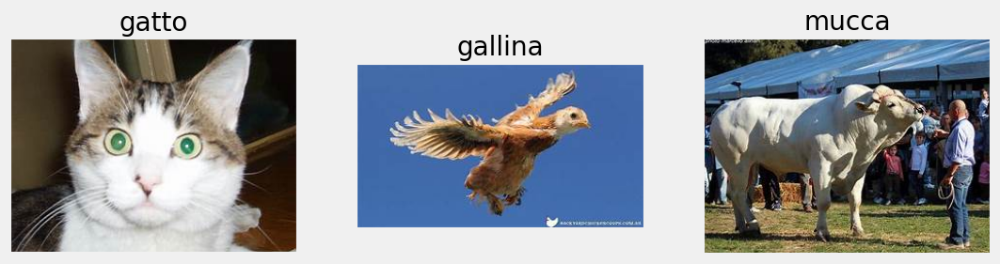

In [ ]:
fig = figure1()

In [8]:
temp_dataset[10000][0].shape, temp_dataset[10000][1]

(torch.Size([3, 128, 128]), 4)

In [9]:
temp_dataset[0][0]

Image([[[0.9059, 0.8980, 0.8902,  ..., 0.9373, 0.9412, 0.9451],
        [0.9020, 0.8941, 0.8863,  ..., 0.9333, 0.9373, 0.9412],
        [0.8941, 0.8902, 0.8824,  ..., 0.9255, 0.9294, 0.9333],
        ...,
        [0.3373, 0.3294, 0.3255,  ..., 0.9451, 0.9490, 0.9529],
        [0.3333, 0.3255, 0.3216,  ..., 0.9451, 0.9490, 0.9529],
        [0.3373, 0.3255, 0.3255,  ..., 0.9490, 0.9529, 0.9569]],

       [[0.9059, 0.8980, 0.8902,  ..., 0.9098, 0.9137, 0.9176],
        [0.9020, 0.8941, 0.8863,  ..., 0.9059, 0.9098, 0.9137],
        [0.8941, 0.8902, 0.8824,  ..., 0.8980, 0.9020, 0.9059],
        ...,
        [0.3451, 0.3373, 0.3333,  ..., 0.9255, 0.9294, 0.9333],
        [0.3412, 0.3333, 0.3294,  ..., 0.9255, 0.9294, 0.9333],
        [0.3451, 0.3333, 0.3333,  ..., 0.9294, 0.9333, 0.9373]],

       [[0.8667, 0.8588, 0.8510,  ..., 0.8863, 0.8902, 0.8941],
        [0.8627, 0.8549, 0.8471,  ..., 0.8824, 0.8863, 0.8902],
        [0.8549, 0.8510, 0.8431,  ..., 0.8745, 0.8784, 0.8824],
        ..

In [10]:
train_dataset_size = len(temp_dataset)
print(f"Tamanho do dataset: {train_dataset_size} imagens")

num_classes = len(temp_dataset.classes)
print(f"Número de classes: {num_classes}")

Tamanho do dataset: 20938 imagens
Número de classes: 10


In [11]:
temp_dataset[0][0].shape, temp_dataset[0][1]

(torch.Size([3, 128, 128]), 0)

In [12]:
temp_dataset[0][0]

Image([[[0.9059, 0.8980, 0.8902,  ..., 0.9373, 0.9412, 0.9451],
        [0.9020, 0.8941, 0.8863,  ..., 0.9333, 0.9373, 0.9412],
        [0.8941, 0.8902, 0.8824,  ..., 0.9255, 0.9294, 0.9333],
        ...,
        [0.3373, 0.3294, 0.3255,  ..., 0.9451, 0.9490, 0.9529],
        [0.3333, 0.3255, 0.3216,  ..., 0.9451, 0.9490, 0.9529],
        [0.3373, 0.3255, 0.3255,  ..., 0.9490, 0.9529, 0.9569]],

       [[0.9059, 0.8980, 0.8902,  ..., 0.9098, 0.9137, 0.9176],
        [0.9020, 0.8941, 0.8863,  ..., 0.9059, 0.9098, 0.9137],
        [0.8941, 0.8902, 0.8824,  ..., 0.8980, 0.9020, 0.9059],
        ...,
        [0.3451, 0.3373, 0.3333,  ..., 0.9255, 0.9294, 0.9333],
        [0.3412, 0.3333, 0.3294,  ..., 0.9255, 0.9294, 0.9333],
        [0.3451, 0.3333, 0.3333,  ..., 0.9294, 0.9333, 0.9373]],

       [[0.8667, 0.8588, 0.8510,  ..., 0.8863, 0.8902, 0.8941],
        [0.8627, 0.8549, 0.8471,  ..., 0.8824, 0.8863, 0.8902],
        [0.8549, 0.8510, 0.8431,  ..., 0.8745, 0.8784, 0.8824],
        ..

In [13]:
dataset_size = len(temp_dataset)
print(f"Dataset size: {dataset_size} images")

# Get number of classes
num_classes = len(temp_dataset.classes)
print(f"Number of classes: {num_classes}")

Dataset size: 20938 images
Number of classes: 10


## **Standardization**

In [14]:
temp_loader = DataLoader(temp_dataset, batch_size=16)

In [15]:
first_images, first_labels = next(iter(temp_loader))
Architecture.statistics_per_channel(first_images, first_labels)

tensor([[16.0000, 16.0000, 16.0000],
        [ 8.9988,  8.2797,  7.6806],
        [ 3.8374,  3.7872,  3.8822]])

In [16]:
results = Architecture.loader_apply(temp_loader, Architecture.statistics_per_channel)
results

tensor([[20938.0000, 20938.0000, 20938.0000],
        [10846.3193, 10474.2559,  8630.6621],
        [ 4356.3975,  4349.5249,  4390.7773]])

In [17]:
normalizer = Architecture.make_normalizer(temp_loader)
normalizer

Normalize(mean=[tensor(0.5180), tensor(0.5003), tensor(0.4122)], std=[tensor(0.2081), tensor(0.2077), tensor(0.2097)], inplace=False)

## **The Real Datasets**

In [18]:
composer = Compose([
    Resize((128,128)),
    ToImage(),
    ToDtype(torch.float32, scale=True),
    normalizer
])

train_data = ImageFolder(root='/content/animals_split/train', transform=composer)
val_data   = ImageFolder(root='/content/animals_split/val', transform=composer)


train_loader = DataLoader(train_data, batch_size=16, shuffle=True)
val_loader   = DataLoader(val_data, batch_size=16)

In [19]:
def figure2(first_images, first_labels):
    fig, axs = plt.subplots(1, 10, figsize=(12, 4))
    titles = ['dog', 'horse', 'elephant','butterfly', 'chicken', 'cat', 'cow', 'sheep', 'spider', 'squirrel']
    for i in range(10):
        image, label = ToPILImage()(first_images[i]), first_labels[i]
        axs[i].imshow(image)
        axs[i].set_xticks([])
        axs[i].set_yticks([])
        axs[i].set_title(titles[label], fontsize=12)
    fig.tight_layout()
    return fig

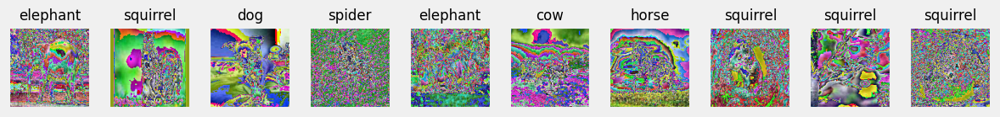

In [20]:
torch.manual_seed(17)
first_images, first_labels = next(iter(train_loader))

fig = figure2(first_images, first_labels)

## **Model Configuration**

In [21]:
torch.manual_seed(13)

model_cnn2 = CNN2(n_feature=32, p=0.3)

multi_loss_fn = nn.CrossEntropyLoss(reduction='mean')

optimizer_cnn2 = optim.Adam(model_cnn2.parameters(), lr=3e-4)

In [22]:
optimizer_cnn2.state_dict()

{'state': {},
 'param_groups': [{'lr': 0.0003,
   'betas': (0.9, 0.999),
   'eps': 1e-08,
   'weight_decay': 0,
   'amsgrad': False,
   'maximize': False,
   'foreach': None,
   'capturable': False,
   'differentiable': False,
   'fused': None,
   'params': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]}]}

In [23]:
arch_cnn2 = Architecture(model_cnn2,
                        multi_loss_fn,
                        optimizer_cnn2)
arch_cnn2.set_loaders(train_loader, val_loader)

In [24]:
arch_cnn2.train(5)

100%|██████████| 5/5 [17:53<00:00, 214.66s/it]


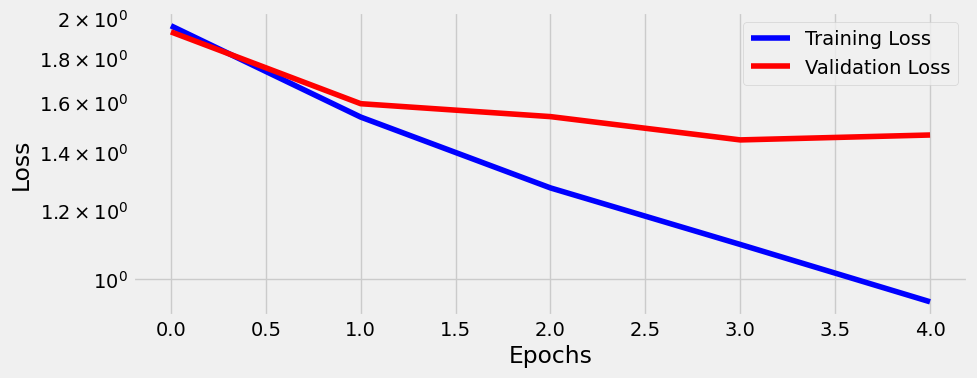

In [25]:
fig = arch_cnn2.plot_losses()

In [26]:
Architecture.loader_apply(val_loader,
                          arch_cnn2.correct)

tensor([[524, 973],
        [285, 525],
        [102, 290],
        [169, 423],
        [362, 620],
        [ 68, 334],
        [ 64, 374],
        [209, 364],
        [836, 965],
        [153, 373]])

In [27]:
Architecture.loader_apply(val_loader,
                          arch_cnn2.correct).sum(axis=0)

tensor([2772, 5241])

In [28]:
(lambda x: x[0].item() / x[1].item())(Architecture.loader_apply(val_loader,
                                                                arch_cnn2.correct).sum(axis=0))

0.5289066971951918

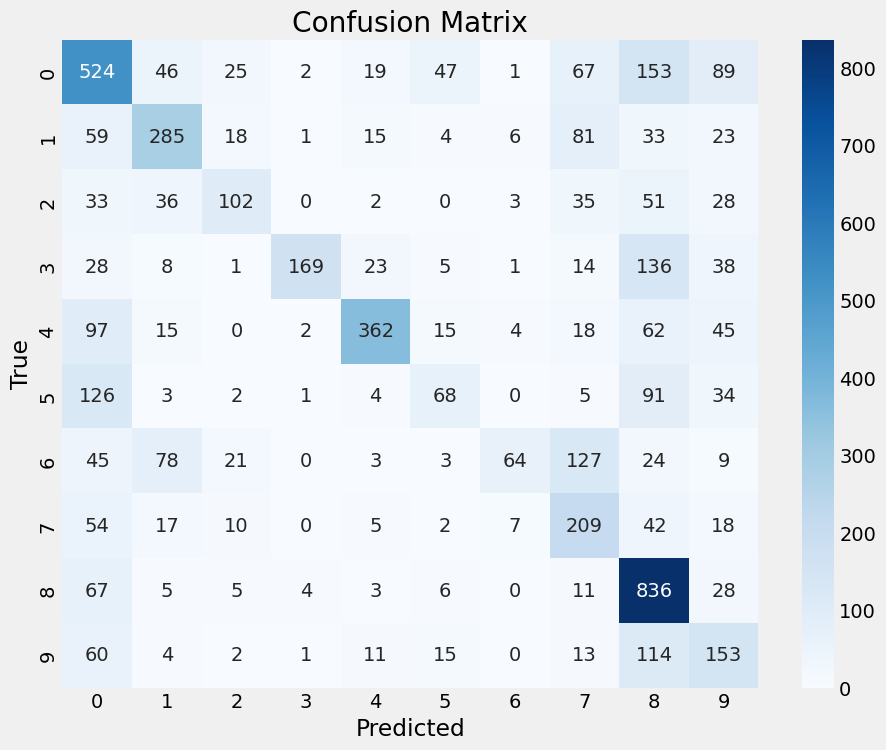

In [29]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

all_preds = []
all_labels = []

with torch.no_grad():
    for x_batch, y_batch in val_loader:
        x_batch = x_batch.to(arch_cnn2.device)
        y_batch = y_batch.to(arch_cnn2.device)

        arch_cnn2.model.eval()
        yhat = arch_cnn2.model(x_batch)

        _, predicted = torch.max(yhat, 1)

        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(y_batch.cpu().numpy())

cm = confusion_matrix(all_labels, all_preds)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
camadas = [name for name, layer in model_cnn2.named_modules() if name]
camadas.remove('drop')

# Coloca o modelo em modo de avaliação
arch_cnn2.model.eval()

# Anexa os hooks usando a lista filtrada de camadas
arch_cnn2.attach_hooks(layers_to_hook=camadas)

# Obtém um batch de imagens
torch.manual_seed(42)
images, labels = next(iter(val_loader))
images = images.to(arch_cnn2.device)

# Propaga as imagens pelo modelo
output = arch_cnn2.model(images)

# Gera visualização dos mapas de características
camadas.remove('fc1')
camadas.remove('fc2')
fig = arch_cnn2.visualize_outputs(layers=camadas)
plt.show()

# Remove os hooks após a visualização
arch_cnn2.remove_hooks()

In [30]:
def make_lr_fn(start_lr, end_lr, num_iter, step_mode='exp'):
    if step_mode == 'linear':
        factor = (end_lr / start_lr - 1) / num_iter
        def lr_fn(iteration):
            return 1 + iteration * factor
    else:  # modo exponencial (default)
        factor = (np.log(end_lr) - np.log(start_lr)) / num_iter
        def lr_fn(iteration):
            return np.exp(factor) ** iteration
    return lr_fn

In [36]:
torch.manual_seed(13)
modelo_novo = CNN2(n_feature=32, p=0.3)
criterio = nn.CrossEntropyLoss()
otimizador_novo = optim.Adam(modelo_novo.parameters(), lr=1e-5)

In [37]:
sbs_novo = Architecture(modelo_novo, criterio, otimizador_novo)

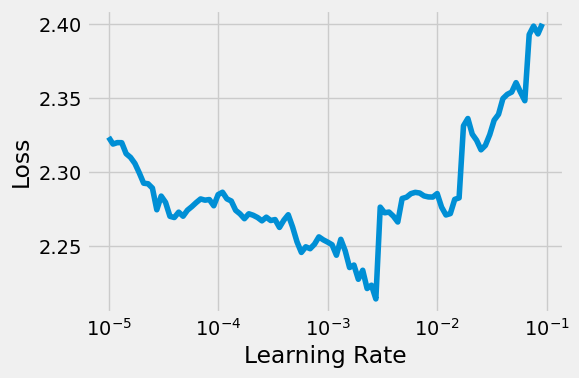

In [38]:
tracking, fig = sbs_novo.lr_range_test(
    data_loader=train_loader,
    end_lr=1e-1,
    num_iter=100,
    step_mode='exp',  # ou 'linear'
    alpha=0.05
)
plt.show()

# Novo modelo

In [39]:
torch.manual_seed(13)

model_cnn2 = CNN2(n_feature=32, p=0.3)

multi_loss_fn = nn.CrossEntropyLoss(reduction='mean')

optimizer_cnn2 = optim.Adam(model_cnn2.parameters(), lr=2e-5)

In [40]:
arch_cnn2 = Architecture(model_cnn2,
                        multi_loss_fn,
                        optimizer_cnn2)
arch_cnn2.set_loaders(train_loader, val_loader)

In [41]:
arch_cnn2.train(5)

100%|██████████| 5/5 [17:44<00:00, 212.94s/it]


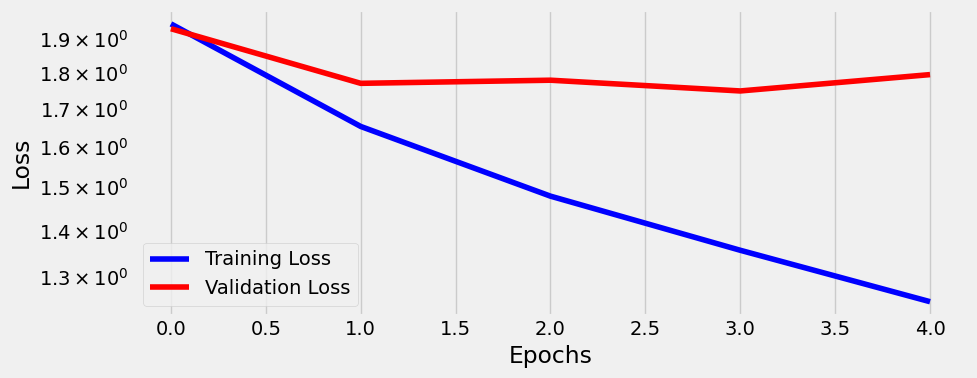

In [42]:
fig = arch_cnn2.plot_losses()

In [43]:
(lambda x: x[0].item() / x[1].item())(Architecture.loader_apply(val_loader,
                                                                arch_cnn2.correct).sum(axis=0))

0.3783629078420149